In [1]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import loompy as lp
import json
import zlib
import base64
import umap
from pyscenic.plotting import plot_binarization
from pyscenic.export import add_scenic_metadata
# from pyscenic.cli.utils import load_signatures
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

c:\Users\16220\anaconda3\envs\pyscenic\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
sc.settings.verbosity = 3 # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=150)

-----
anndata     0.10.8
scanpy      1.10.2
-----
PIL                         10.3.0
anyio                       NA
asttokens                   NA
attr                        23.1.0
attrs                       23.1.0
babel                       2.11.0
boltons                     NA
brotli                      1.0.9
certifi                     2024.07.04
cffi                        1.16.0
charset_normalizer          3.1.0
cloudpickle                 3.0.0
colorama                    0.4.6
comm                        0.2.1
ctxcore                     0.2.0
cycler                      0.12.1
cython_runtime              NA
cytoolz                     0.12.3
dask                        2024.5.1
dateutil                    2.9.0.post0
debugpy                     1.6.7
decorator                   5.1.1
defusedxml                  0.7.1
exceptiongroup              1.2.0
executing                   0.8.3
fastjsonschema              NA
frozendict                  2.4.4
h5py                      

In [19]:
os.chdir(r"F:\gdT_aim2\SCENIC")

In [5]:
f_loom_path_scenic = r"F:\gdT_aim2\SCENIC\SCENIC_output\gdT_cancer_only.loom"
f_pyscenic_output = r"F:\gdT_aim2\SCENIC\SCENIC_output\pyscenic_output_cancer_only.loom"

In [6]:
from matplotlib.colors import LinearSegmentedColormap
values = [0, 1]
colors = [(227, 227, 227), (255, 42, 18)]
colors = [tuple(np.array(color) / 255) for color in colors]
my_cmap = LinearSegmentedColormap.from_list('', colors)

In [6]:
# adata = sc.read_loom(f_loom_path_scenic)

In [106]:
adata = sc.read_h5ad(r"F:\gdT_aim2\organized_data\unimputed\gdT_integrated.h5ad")

In [107]:
adata_cancer = adata[adata.obs['tissue']=='Carcinoma']

## Visualize Co-expression

In [108]:
no_source_grn = pd.read_csv(r"F:\gdT_aim2\SCENIC\predicted_GRN_no_source.csv") # read in the vanilla nichenet + ours SCENIC grn

In [116]:
corr_mat = pd.DataFrame(index = no_source_grn['tf'].drop_duplicates(), columns = no_source_grn['target'])

In [117]:
corr_mat

target,CBWD3,S1PR4,FAM49B,DNAJC8,DEPDC1,CCNJL,GSN,TTC22,CCDC94,FAM131B,...,EID2,CRIP1,UBA3,MTMR1,ORC4,RAD51C,RAD52,TMEM126B,NCF4,ZNF41
tf,,,,,,,,,,,,,,,,,,,,,
ARID3A,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ATF1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ATF2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ATF3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ATF6B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZNF785,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ZNF808,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ZNF814,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Export reg pairs for NicheNet

In [7]:
reg = pd.read_csv(r'SCENIC_output\reg_cancer_only.csv',skiprows=[0])
reg = reg.rename(columns={reg.columns[0]: reg.iloc[0, 0], reg.columns[1]: reg.iloc[0, 1]})
reg = reg.iloc[1:].reset_index(drop=True)

In [8]:
rep_dict = {'[':'',']':'','(':'',')':'',"'":'',' ':'',"\\":'',"{":'',"}":'','"':''}

In [9]:
for j in range(len(reg.index)):
    for i in rep_dict.keys():
        reg['TargetGenes'][j] = reg['TargetGenes'][j].replace(i, rep_dict[i])
    reg['TargetGenes'][j]= reg['TargetGenes'][j].split(',')

C:\Users\16220\AppData\Local\Temp\ipykernel_26588\230556113.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  reg['TargetGenes'][j] = reg['TargetGenes'][j].replace(i, rep_dict[i])
C:\Users\16220\AppData\Local\Temp\ipykernel_26588\230556113

In [10]:
GB = reg.groupby('TF')['TargetGenes'].sum()

# List to store each DataFrame for concatenation later
dfs = []

# Iterate over each group
for tf in GB.keys():
    sep_list = GB[tf]
    gene_id = np.arange(0, len(sep_list), 2)
    enrich_id = gene_id + 1
    df = pd.DataFrame({'tf': tf, 
                       'target': np.array(sep_list)[gene_id], 
                       'enrichment': np.array(sep_list)[enrich_id]})
    df['enrichment'] = df['enrichment'].astype(float)
    dfs.append(df)

In [11]:
total_reg_df = pd.concat(dfs, ignore_index=True)

In [12]:
total_reg_df.head()

,tf,target,enrichment
0,ARID3A,CBWD3,0.736704
1,ARID3A,LYRM7,0.433477
2,ARID3A,BSG,0.531946
3,ARID3A,NFKB1,0.864075
4,ARID3A,S1PR4,1.038054


In [13]:
total_reg_df.to_csv('reg_pairs_cancer_only.csv')

## After AUCell

### data preparation

In [10]:
# collect SCENIC AUCell output
lf = lp.connect( f_pyscenic_output, mode='r+', validate=False )
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)
lf.close()

In [12]:
runUmap = umap.UMAP(n_neighbors=10, min_dist=0.4, metric='correlation').fit_transform
dr_umap = runUmap( auc_mtx )
pd.DataFrame(dr_umap, columns=['X', 'Y'], index=auc_mtx.index).to_csv( "scenic_umap.txt", sep='\t')

In [13]:
lf = lp.connect(f_pyscenic_output, mode='r+', validate=False )
meta = json.loads(zlib.decompress(base64.b64decode( lf.attrs.MetaData )))
#exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID)
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)
regulons = lf.ra.Regulons
dr_umap = pd.read_csv('scenic_umap.txt', sep='\t', header=0, index_col=0 )

In [14]:
auc_mtx.columns = auc_mtx.columns.str.replace('\(','_(')
regulons.dtype.names = tuple( [ x.replace("(","_(") for x in regulons.dtype.names ] )
# regulon thresholds
rt = meta['regulonThresholds']
for i,x in enumerate(rt):
    tmp = x.get('regulon').replace("(","_(")
    x.update( {'regulon': tmp} )

In [15]:
umapDF = pd.DataFrame(adata_cancer.obsm['X_umap'], columns=['_X', '_Y'])

In [16]:
Embeddings_Y = pd.DataFrame( index=lf.ca.CellID )
Embeddings_Y = pd.concat( [
        pd.DataFrame(adata_cancer.obsm['X_umap'],index=adata_cancer.obs.index)[1] ,
        pd.DataFrame(adata_cancer.obsm['X_pca'],index=adata_cancer.obs.index)[1] ,
        dr_umap['Y']
    ], sort=False, axis=1, join='outer' )
Embeddings_Y.columns = ['UMAP','PCA','AUC_UMAP']

In [17]:
Embeddings_X = pd.DataFrame( index=lf.ca.CellID )
Embeddings_X = pd.concat( [
        pd.DataFrame(adata_cancer.obsm['X_umap'],index=adata_cancer.obs.index)[0] ,
        pd.DataFrame(adata_cancer.obsm['X_pca'],index=adata_cancer.obs.index)[0] ,
        dr_umap['X']
    ], sort=False, axis=1, join='outer' )
Embeddings_X.columns = ['UMAP','PCA','AUC_UMAP']

In [18]:
### metadata
metaJson = {}

metaJson['embeddings'] = [
    {
        "id": -1,
        "name": f"Scanpy UMAP  (highly variable genes)"
    },
    {
        "id": 1,
        "name": "Scanpy PC1/PC2"
    },
    {
        "id": 2,
        "name": "SCENIC AUC UMAP"
    },
]

metaJson["clusterings"] = [{
            "id": 0,
            "group": "Scanpy",
            "name": "Scanpy leiden default resolution",
            "clusters": [],
        }]

metaJson["metrics"] = [
        {
            "name": "nUMI"
        }, {
            "name": "nGene"
        }
]

metaJson["annotations"] = [
    {
        "name": "Final_Clusters",
        "values": list(set(adata_cancer.obs['cluster_blind'].astype(str) ))
    },
    {
        "name": "Source",
        "values": list(set(adata_cancer.obs['orig.ident'].values))
    },
    {
        "name": "Patient",
        "values": list(set(adata_cancer.obs['patient'].values))
    },
    {
        "name": "Tissue",
        "values": list(set(adata_cancer.obs['tissue'].values))
    },
    {
        "name": "Gender",
        "values": list(set(adata_cancer.obs['gender'].values))
    },
    {
        "name": "Age",
        "values": list(set(adata_cancer.obs['age'].values))
    },
    {
        "name": "Site",
        "values": list(set(adata_cancer.obs['site'].values))
    },
    {
        "name": "Stage",
        "values": list(set(adata_cancer.obs['stage'].values))
    }
    ,
    {
        "name": "CellTypes",
        "values": list(set(adata_cancer.obs['cell type'].values))
    }
]

# SCENIC regulon thresholds:
metaJson["regulonThresholds"] = rt

for i in range(max(set([int(x) for x in adata_cancer.obs['cluster_blind']])) + 1):
    clustDict = {}
    clustDict['id'] = i
    clustDict['description'] = f'Unannotated Cluster {i + 1}'
    metaJson['clusterings'][0]['clusters'].append(clustDict)
    
clusterings = pd.DataFrame()
clusterings["0"] = adata_cancer.obs['cluster_blind'].values.astype(np.int64)

In [19]:
def dfToNamedMatrix(df):
    arr_ip = [tuple(i) for i in df.values]
    dtyp = np.dtype(list(zip(df.dtypes.index, df.dtypes)))
    arr = np.array(arr_ip, dtype=dtyp)
    return arr

In [20]:
col_attrs = {
    "CellID": np.array(adata_cancer.obs.index),
    "nUMI": np.array(adata_cancer.obs['nCount_RNA'].values),
    "nGene": np.array(adata_cancer.obs['nFeature_RNA'].values),
    "CellTypes": np.array( adata_cancer.obs['cell type'].values ),
    "Percent_mito": np.array(adata_cancer.obs['percent.mt'].values),
    "Source": np.array(adata_cancer.obs['orig.ident'].values),
    "Patient": np.array(adata_cancer.obs['patient'].values),
    "Tissue": np.array(adata_cancer.obs['tissue'].values),
    "Gender": np.array(adata_cancer.obs['gender'].values),
    "Age": np.array(adata_cancer.obs['age'].values),
    "Site":np.array(adata_cancer.obs['site'].values),
    "Stage": np.array(adata_cancer.obs['stage'].values),
    "Embedding": dfToNamedMatrix(umapDF),
    "Embeddings_X": dfToNamedMatrix(Embeddings_X),
    "Embeddings_Y": dfToNamedMatrix(Embeddings_Y),
    "RegulonsAUC": dfToNamedMatrix(auc_mtx),
    "Clusterings": dfToNamedMatrix(clusterings),
    "ClusterID": np.array(adata_cancer.obs['cluster_blind'].values)
}



row_attrs = {
    "Gene": lf.ra.Gene,
    "Regulons": regulons,
}

attrs = {
    "title": "gdT",
    "MetaData": json.dumps(metaJson),
    "Genome": 'hg38',
    "SCopeTreeL1": "",
    "SCopeTreeL2": "",
    "SCopeTreeL3": ""
}

# compress the metadata field:
attrs['MetaData'] = base64.b64encode(zlib.compress(json.dumps(metaJson).encode('ascii'))).decode('ascii')

In [21]:
f_final_loom = 'final_scenic_output_cancer_only.loom'
lp.create(
    filename = f_final_loom ,
    layers=lf[:,:],
    row_attrs=row_attrs, 
    col_attrs=col_attrs, 
    file_attrs=attrs
)
lf.close()

### visualize the output
if already generated f_final_loom = 'final_scenic_output.loom', just jump to here

In [22]:
# scenic output
f_final_loom = 'final_scenic_output_cancer_only.loom'
lf = lp.connect( f_final_loom, mode='r', validate=False )
meta = json.loads(zlib.decompress(base64.b64decode( lf.attrs.MetaData )))
exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID).T
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)

In [23]:
# create a dictionary of regulons:
regulons = {}
for i,r in pd.DataFrame(lf.ra.Regulons,index=lf.ra.Gene).items():
    regulons[i] =  list(r[r==1].index.values)

In [24]:
cellAnnot = adata_cancer.obs

In [25]:
dr_umap = pd.read_csv('scenic_umap.txt', sep='\t', header=0, index_col=0 )
adata_cancer.obsm['X_auc_umap'] = dr_umap.values

C:\Users\16220\AppData\Local\Temp\ipykernel_10672\2128012984.py:2: ImplicitModificationWarning: Setting element `.obsm['X_auc_umap']` of view, initializing view as actual.
  adata_cancer.obsm['X_auc_umap'] = dr_umap.values


#### logos

In [71]:
from pyscenic.utils import load_motifs
import operator as op
from IPython.display import HTML, display

BASE_URL = "http://motifcollections.aertslab.org/v9/logos/"
COLUMN_NAME_LOGO = "MotifLogo"
COLUMN_NAME_MOTIF_ID = "MotifID"
COLUMN_NAME_TARGETS = "TargetGenes"

def display_logos(df: pd.DataFrame, top_target_genes: int = 3, base_url: str = BASE_URL):
    """
    :param df:
    :param base_url:
    """
    # Make sure the original dataframe is not altered.
    df = df.copy()
    
    # Add column with URLs to sequence logo.
    def create_url(motif_id):
        return '<img src="{}{}.png" style="max-height:124px;"></img>'.format(base_url, motif_id)
    df[("Enrichment", COLUMN_NAME_LOGO)] = list(map(create_url, df.index.get_level_values(COLUMN_NAME_MOTIF_ID)))
    
    # Truncate TargetGenes.
    def truncate(col_val):
        return sorted(col_val, key=op.itemgetter(1))[:top_target_genes]
    df[("Enrichment", COLUMN_NAME_TARGETS)] = list(map(truncate, df[("Enrichment", COLUMN_NAME_TARGETS)]))
    
    MAX_COL_WIDTH = pd.get_option('display.max_colwidth')
    pd.set_option('display.max_colwidth', 200)
    display(HTML(df.head().to_html(escape=False)))
    pd.set_option('display.max_colwidth', MAX_COL_WIDTH)

In [5]:
# from pyscenic.utils import load_motifs
# df_motifs = load_motifs('reg.csv')

In [88]:
df_motifs

Enrichment  \
                                                                 AUC   
TF     MotifID                                                         
ATF7   transfac_pro__M01861                                 0.080550   
CARF   transfac_pro__M07447                                 0.072678   
CREM   transfac_pro__M01861                                 0.069395   
       transfac_pro__M04746                                 0.055212   
       transfac_pro__M02279                                 0.049423   
...                                                              ...   
TFDP1  transfac_pro__M00803                                 0.050885   
YY1    hocomoco__TYY2_HUMAN.H11MO.0.D                       0.054950   
ZBTB2  taipale_cyt_meth__ZBTB2_NTTTCCGGTAMN_eDBD_meth_...   0.070674   
       taipale_cyt_meth__ZBTB2_NTTTMCGGTWAN_eDBD            0.067291   
ZNF573 transfac_pro__M06414                                 0.081106   

                                                                     \
                                                                NES   
TF     MotifID                                                        
ATF7   transfac_pro__M01861                                3.169866   
CARF   transfac_pro__M07447                                3.611745   
CREM   transfac_pro__M01861                                5.903955   
       transfac_pro__M04746                                3.861934   
       transfac_pro__M02279                                3.028409   
...                                                             ...   
TFDP1  transfac_pro__M00803                                3.007081   
YY1    hocomoco__TYY2_HUMAN.H11MO.0.D                      3.420603   
ZBTB2  taipale_cyt_meth__ZBTB2_NTTTCCGGTAMN_eDBD_meth_...  4.415213   
       taipale_cyt_meth__ZBTB2_NTTTMCGGTWAN_eDBD           4.059760   
ZNF573 transfac_pro__M06414                                4.151974   

                                                                                 \
                                                          MotifSimilarityQvalue   
TF     MotifID                                                                    
ATF7   transfac_pro__M01861                                            0.000883   
CARF   transfac_pro__M07447                                            0.000000   
CREM   transfac_pro__M01861                                            0.000752   
       transfac_pro__M04746                                            0.000310   
       transfac_pro__M02279                                            0.000274   
...                                                                         ...   
TFDP1  transfac_pro__M00803                                            0.000000   
YY1    hocomoco__TYY2_HUMAN.H11MO.0.D                                  0.000006   
ZBTB2  taipale_cyt_meth__ZBTB2_NTTTCCGGTAMN_eDBD_meth_...              0.000000   
       taipale_cyt_meth__ZBTB2_NTTTMCGGTWAN_eDBD                       0.000000   
ZNF573 transfac_pro__M06414                                            0.000000   

                                                                               \
                                                          OrthologousIdentity   
TF     MotifID                                                                  
ATF7   transfac_pro__M01861                                               1.0   
CARF   transfac_pro__M07447                                               1.0   
CREM   transfac_pro__M01861                                               1.0   
       transfac_pro__M04746                                               1.0   
       transfac_pro__M02279                                               1.0   
...                                                                       ...   
TFDP1  transfac_pro__M00803                                               1.0   
YY1    hocomoco__TYY2_HUMAN.H11MO.0.D                                     1.0   


In [67]:
selected_motifs = ['PAX5','TCF3','EBF1']
df_motifs_sel = df_motifs.iloc[ [ True if x in selected_motifs else False for x in df_motifs.index.get_level_values('TF') ] ,:]

In [69]:
display_logos( df_motifs_sel.sort_values([('Enrichment','NES')], ascending=False).head(9))

#### Regulon specificity scores (RSS) across predicted cell types

In [26]:
from pyscenic.rss import regulon_specificity_scores
from pyscenic.plotting import plot_rss
import matplotlib.pyplot as plt
from adjustText import adjust_text
import seaborn as sns
from pyscenic.binarization import binarize

In [27]:
rss_cellType = regulon_specificity_scores( auc_mtx, cellAnnot['cell type'] )

In [28]:
auc_mtx

,ARID3A(+),ATF1(+),ATF2(+),ATF3(+),ATF6B(+),BACH1(+),BACH2(+),BHLHE40(+),BPTF(+),CDX2(+),...,ZNF567(+),ZNF580(+),ZNF669(+),ZNF77(+),ZNF780A(+),ZNF785(+),ZNF808(+),ZNF814(+),ZNF836(+),ZSCAN29(+)
AAAGATGTCCCGACTT-1_3,0.006054,0.115414,0.000000,0.074846,0.059354,0.000000,0.084907,0.130777,0.050763,0.043152,...,0.000000,0.034516,0.000000,0.054571,0.000000,0.027144,0.000000,0.041372,0.089952,0.000000
AAAGCAAAGGTGCACA-1_3,0.025673,0.060419,0.000000,0.060385,0.026362,0.024442,0.000000,0.112916,0.048366,0.056774,...,0.027478,0.054020,0.000000,0.037982,0.023353,0.000000,0.000000,0.000000,0.046922,0.000000
AAAGCAAAGTAGATGT-1_3,0.126182,0.077762,0.116044,0.067147,0.060989,0.060433,0.000000,0.239152,0.053447,0.013198,...,0.000000,0.044769,0.047702,0.008718,0.000000,0.000000,0.000000,0.000000,0.075105,0.000000
AACCATGGTGTTAAGA-1_3,0.045151,0.059788,0.000000,0.084882,0.049482,0.000000,0.000000,0.087084,0.049580,0.031016,...,0.000000,0.060814,0.002018,0.036670,0.000000,0.000000,0.000000,0.031685,0.000000,0.042381
AAGACCTGTCTCCCTA-1_3,0.057987,0.068807,0.000000,0.060522,0.027455,0.000000,0.000000,0.000000,0.051516,0.069069,...,0.000000,0.054603,0.000000,0.049768,0.000000,0.000000,0.000000,0.040565,0.068185,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
KUL5_EXT127_CGAGCCAAGGGTTTCT-1,0.077160,0.003973,0.000000,0.123628,0.039649,0.066712,0.158714,0.155499,0.065283,0.000000,...,0.000000,0.069338,0.091368,0.019314,0.000000,0.118063,0.132694,0.000000,0.029840,0.000000
KUL5_EXT127_GTTCGGGCAGGCAGTA-1,0.054655,0.007505,0.000000,0.099351,0.045362,0.065815,0.000000,0.141574,0.056420,0.001407,...,0.017542,0.061723,0.000000,0.048174,0.125991,0.000000,0.000000,0.000000,0.091610,0.000000
KUL5_EXT127_TCAACGAAGCTGATAA-1,0.043297,0.014253,0.138581,0.092087,0.048286,0.221550,0.084330,0.282644,0.053170,0.002868,...,0.000000,0.061353,0.000000,0.041271,0.035318,0.000000,0.000000,0.031887,0.031858,0.065158
KUL5_EXT128_ACCTTTAGTCCCTTGT-1,0.017084,0.045661,0.079213,0.111725,0.040588,0.000000,0.000000,0.276791,0.044126,0.027909,...,0.000000,0.067326,0.000000,0.019778,0.000000,0.073562,0.069374,0.000000,0.000000,0.000000


<Axes: title={'center': 'EOMES AUC Dist'}, ylabel='Frequency'>

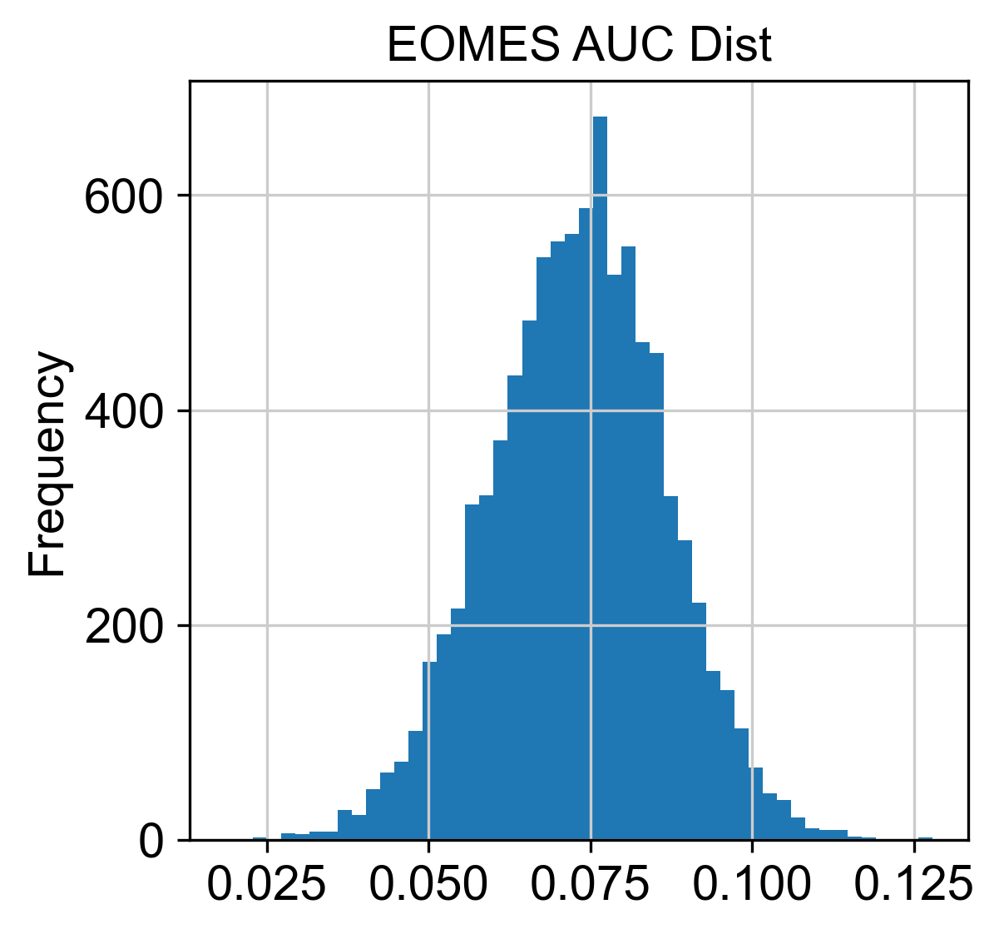

In [29]:
auc_mtx['EOMES(+)'].plot.hist(bins = 50,title = 'EOMES AUC Dist')

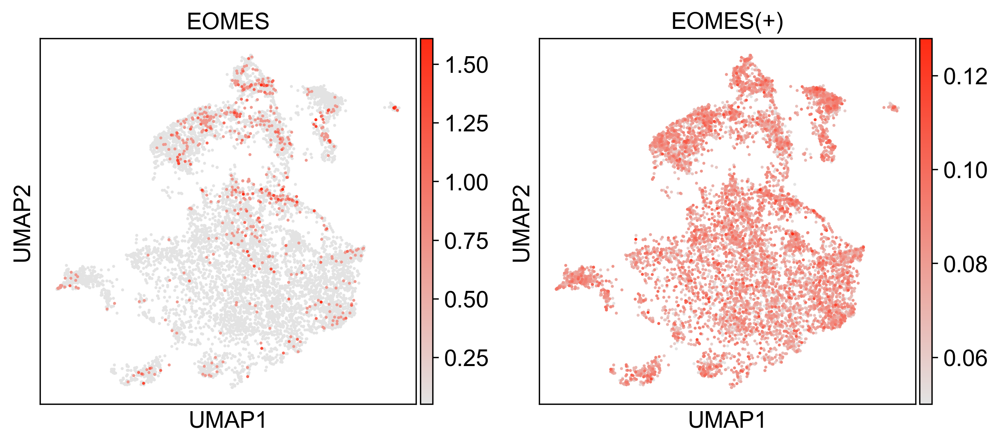

In [31]:
adata_cancer.obs['EOMES(+)'] = auc_mtx['EOMES(+)']
sc.pl.umap(adata_cancer, color = ['EOMES','EOMES(+)'],cmap = my_cmap,vmin = 0.05)

In [32]:
adata.obs['RORC(+)'] = auc_mtx['RORC(+)']
sc.pl.umap(adata, color = ['RORC','RORC(+)'],cmap = my_cmap,vmin = 0.05)

KeyError: 'RORC(+)'

In [ ]:
rss_cellType.to_csv('rss_cellType_cancer_only.csv')

In [38]:
general_type = adata_cancer.obs['cell type'].astype(str)
general_type = general_type.replace({r'IL7R.* TRM':'TRM', r'^.*Teff.*':'Teff','^.*Tex.*':'Tex'},regex=True)
adata_cancer.obs['general type'] = general_type
cellAnnot = adata_cancer.obs
rss_cellType = regulon_specificity_scores( auc_mtx, cellAnnot['general type'] )

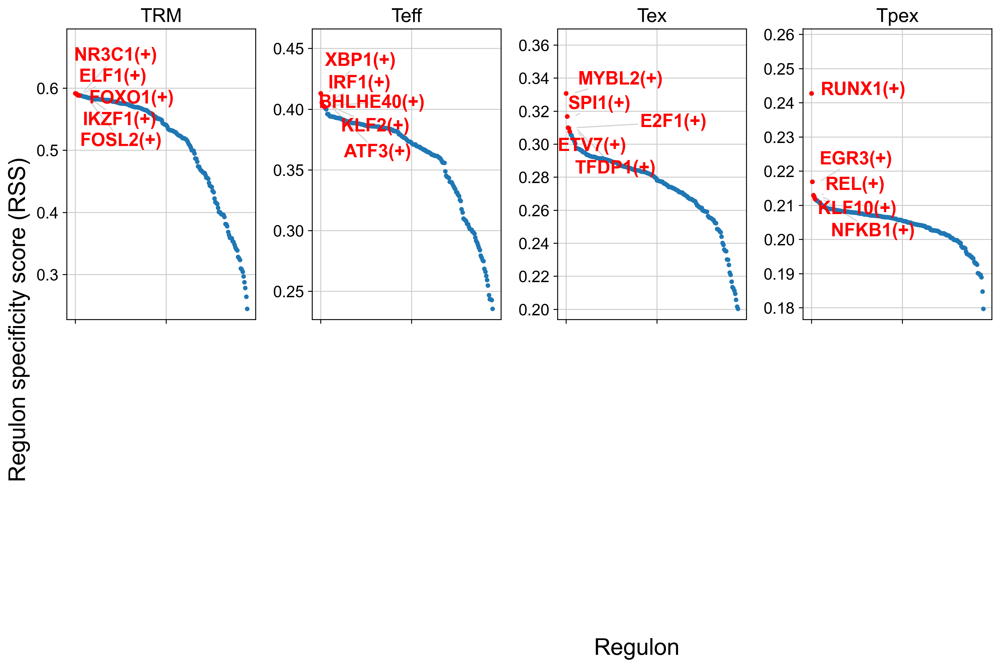

In [47]:
cats = sorted(list(set(cellAnnot['general type'])))

fig = plt.figure(figsize=(15, 8))
for c,num in zip(cats, range(1,len(cats)+1)):
    x=rss_cellType.T[c]
    ax = fig.add_subplot(2,5,num)
    plot_rss(rss_cellType, c, top_n=5, max_n=None, ax=ax)
    ax.set_ylim( x.min()-(x.max()-x.min())*0.05 , x.max()+(x.max()-x.min())*0.3 )
    for t in ax.texts:
        t.set_fontweight('bold')
        t.set_fontsize(16)
    ax.set_ylabel('')
    ax.set_xlabel('')
    adjust_text(ax.texts, arrowprops=dict(arrowstyle='-',color='lightgrey') )
 
fig.text(0.5, 0.0, 'Regulon', ha='center', va='center', size='x-large')
fig.text(0.00, 0.5, 'Regulon specificity score (RSS)', ha='center', va='center', rotation='vertical', size='x-large')
plt.tight_layout()
plt.rcParams.update({
    'figure.autolayout': True,
        'figure.titlesize': 'large' ,
        'axes.labelsize': 'medium',
        'axes.titlesize':'large',
        'xtick.labelsize':'medium',
        'ytick.labelsize':'medium'
        })
plt.savefig("general_type_TF_activities.png", dpi=600, bbox_inches = "tight")
# plt.show()

## Overlap with CHIPseq (integrate with nichenet grn first)
Here we use TBX21 and the TBX21 CHIPseq online for Th1 cells as an example

In [17]:
gtf_file = r"F:\gdT_aim2\SCENIC\SCENIC_database\Homo_sapiens.GRCh38.113.chr.gtf.gz"
gtf_data = pd.read_csv(gtf_file, sep="\t", comment="#", header=None)

C:\Users\16220\AppData\Local\Temp\ipykernel_26032\175377675.py:2: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  gtf_data = pd.read_csv(gtf_file, sep="\t", comment="#", header=None)


In [18]:
# Filter for 'gene' feature
genes = gtf_data[gtf_data[2] == "gene"]

# Extract necessary columns (e.g., chromosome, start, end, strand, gene name)
genes = genes[[0, 3, 4, 6, 8]]
genes.columns = ["chrom", "start", "end", "strand", "attributes"]

# Extract gene names
genes["gene_name"] = genes["attributes"].str.extract('gene_name "([^"]+)"')

In [15]:
no_source_grn = pd.read_csv(r"F:\gdT_aim2\SCENIC\predicted_GRN_no_source.csv") # read in the vanilla nichenet + ours SCENIC grn

In [25]:
for tf in set(no_source_grn['tf']):
    target_genes = no_source_grn['target'][no_source_grn['tf']==tf]
    tss_regions = genes[genes["gene_name"].isin(target_genes)]
    tss_regions["tss"] = tss_regions.apply(lambda x: x["start"] if x["strand"] == "+" else x["end"], axis=1)
    tss_regions["start"] = tss_regions["tss"] - 5000
    tss_regions["end"] = tss_regions["tss"] + 5000
    tss_regions['chrom'] = 'chr'+tss_regions['chrom'].astype(str).map(str)

    # Save as BED file for overlap analysis
    tss_regions[["chrom", "start", "end", "gene_name"]].to_csv("SCENIC_database/TF_target_genes_tss/no_source_tss_5kb_for_"+tf+".bed", sep="\t", index=False, header=False)

C:\Users\16220\AppData\Local\Temp\ipykernel_26032\3866615841.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tss_regions["tss"] = tss_regions.apply(lambda x: x["start"] if x["strand"] == "+" else x["end"], axis=1)
C:\Users\16220\AppData\Local\Temp\ipykernel_26032\3866615841.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tss_regions["start"] = tss_regions["tss"] - 5000
C:\Users\16220\AppData\Local\Temp\ipykernel_26032\3866615841.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of

it is time to go back to R (CHIPseq_SCENIC_verify.R)

then, after getting the CHIP verification

In [30]:
from matplotlib.colors import LinearSegmentedColormap
values = [0,1]
colors = [(227, 227, 227), (15, 247, 74)]
norm = plt.Normalize(min(values), max(values))
my_cmap = LinearSegmentedColormap.from_list(
    '', [(norm(value), tuple(np.array(color) / 255)) for value, color in zip(values, colors)])

In [29]:
verified = pd.read_csv('verified_target_percentage.csv')

In [92]:
plot_df

CEBPB     0.184211
ETS1      0.354167
FOS       0.076923
FOSL1     0.076923
FOSL2     0.294355
FOXP3     0.000000
GATA3     0.214286
IRF4      0.166667
JUNB      0.534653
NFATC1    0.000000
NFKB1     0.138889
REL       0.442308
RUNX1     0.250000
SMAD3     0.035714
STAT1     0.000000
STAT5A    0.000000
STAT5B    0.250000
TBX21     0.888889
YY1       0.230769
Name: Target Verified Percentage, dtype: float64

In [105]:
%matplotlib inline
plt.rcParams.update(plt.rcParamsDefault)
plt.rcParams.update({'font.size': 12, 'font.weight': 'heavy','axes.linewidth':2})
kwargs = {'cmap': my_cmap}



plot_df = verified.copy().T[1]
plot_df.name = 'Target Verified Percentage'
clustergrid = sns.clustermap(plot_df,figsize = (3,8),linewidths=2,
            linecolor = 'k',dendrogram_ratio = 0.1, colors_ratio = 0.5, cbar_pos= None,
            row_cluster = False,col_cluster = False,#cbar_kws={'label': 'NicheNet ligand activity (AUROC)','location':"left"},
            **kwargs)


axs = clustergrid.fig.get_axes()
for j in range(0,len(axs)): 
    axs[j].set_xlabel('')

ax = clustergrid.ax_heatmap

# Extract data values and annotate each cell
for i in range(plot_df.shape[0]):  # Iterate over rows
    for j in range(1):  # Since there's only one column
        value = plot_df.iloc[i] # Get value
        # print(value)
        ax.text(j+0.5, i+0.5, f'{value:.4f}', ha='center', va='center', color='black', fontsize=12, fontweight='bold')
# plt.show()
plt.savefig('vis/ligand_verified.png',dpi = 300,bbox_inches='tight')